<img alt='UCL' src="images/ucl_logo.png" align='center'>


[<img src="images/noun_post_2109127.svg" width="50" align='right'>](016_Python_for.ipynb)
[<img src="images/noun_pre_2109128.svg" width="50" align='right'>](018_Python_xxx.ipynb)



# 028 Weighted interpolation

##  Smoothing

We have seen that geospatial datasets often have missing values, and also that the quality (or better, uncertainty) from one pixel to the next, in space or time, may vary.

If we have some expectation that the data should be smooth (in time and/or space), then we can use ideas of regularisation (smoothing) to **improve the accuracy** of the data. Note that any such claimed improvement is conditional on the data being smooth. Any violation of that will be inconsistent with our assumptions and may lead us to mis-interpret the data. Although we will not be doing so here, we can also provide updates on the data uncertainty after regularisation.

When we regularise the data, we want to respond to the variable uncertainty of the data. We have seen in [028_GDAL_timeseries](028_GDAL_timeseries.ipynb) that we can phrase the inverse of uncertainty (i.e. certainty) via a weight. For a single parameter (i.e. assumed no correlations between parameters), this is just a single weight to associate with a data point. If there is no data at some location, we simply have a weight of zero. So, we want to do a weighted regularisation responding to this.

There are many approaches to weighted interpolation. One such is to use a convolution smoothing operation.

In convolution, we combine a *signal* $y$ with a *filter* $f$ to achieve a filtered signal. For example, if we have an noisy signal, we will attempt to reduce the influence of high frequency information in the signal (a 'low pass' filter, as we let the low frequency information *pass*).

In this approach, we define a digital filter (convolution filter) that should be some sort of weighted average function. A typical filter is the Gaussian, defined by the parameter $\sigma$. The larger the value of $\sigma$, the 'wider' the filter, which means that the weighted average will be takjen over a greater extent.

We do not expect you to be overly concerned with the code in these sections below, as the main effort should be directed at understanding smoothing and interpolation at this point.

Let's look at this filter:

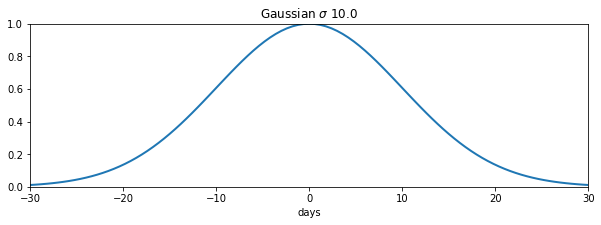

In [1]:
from IPython.display import HTML
from geog0111.demofilt1 import demofilt1

show1 = HTML(demofilt1().to_jshtml())

In [2]:
show1

A digital (discrete) convolution uses a sampled signal and filter (represented on a grid).

Without going into the maths, the convolution operates by running the filter centred on $x_c$ over the extent of the signal as illustrated below.

*At each value of $x_c$*, the filter is **multiplied by the signal**. Clearly, where the filter is zero, the influence of the signal is zero. So, the filter effectively selects a local window of data points (shown as green crosses below). The result, i.e. the filtered signal, is simply the weighted average of these local samples. This can be seen in the lower panel, where the green dot shows the filtered signal at $x_c$.

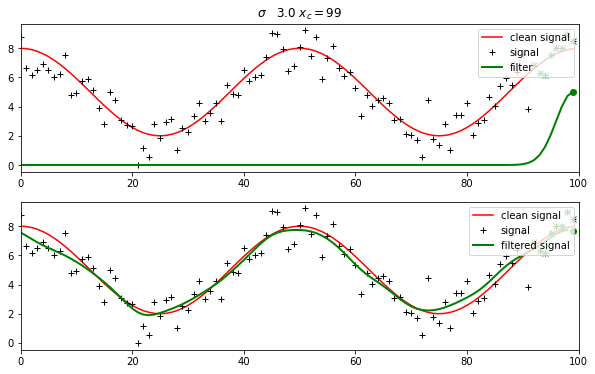

In [3]:
from IPython.display import HTML
from geog0111.demofilt3 import demofilt3

show2=HTML(demofilt3().to_jshtml())

In [4]:
show2

The convolution of a low pass ('smoothing') filter with a signal results in a smoothing of the signal:

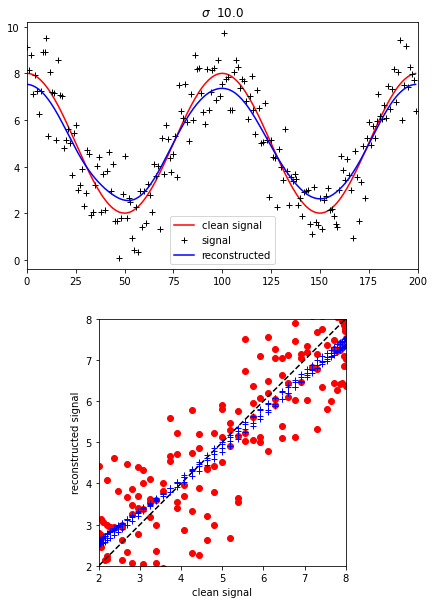

In [5]:
from IPython.display import HTML
from geog0111.demofilt2 import demofilt2

show3 = HTML(demofilt2().to_jshtml())

In [6]:
show3

The degree of smoothing is greater, the larger the value of $\sigma$ (i.e. the broader the convolution filter). Eventually, the signal would go 'flat', i.e. be a constant (weighted mean) value, if we used a very broad filter.

For small values of $\sigma$ though, the signal is still rather noisy. 

There is a trade-off then between noise suppression and the degree of generalisation.

We could define some concept of an 'optimium' value of $\sigma$, for example using [cross validation](https://en.wikipedia.org/wiki/Cross-validation_(statistics)). But often we can decide empirically an appropriate filter width.

We perform the convolution using:

    convolve1d(y, filter,mode='wrap')
    
from the `scipy.ndimage.filters` library.

The first argument is the signal to be filtered. The second is the filter (the Gaussian here). 

We set 

    mode='wrap'
    
which defines the boundary conditions to be periodic ('wrapped around'). This would generally be appropriate for time series e.g. of one year.

## weighted smoothing and interpolation

In the convolution examples above, we apply the smoothing equally to all samples of the signal.


What if we knew that some samples were 'better' (quality) than others? What if some samples were missing? How could we incorporate this information?

The answer is to *weight* the convolution.

For each sample point in the signal, we define a *weight*, where the weight is high if we trust the data point and low if we don't trust it much. We apply a weight of zero if a data point is missing.

Then, the weighted convolution is simply the result of applying the filter to (weight $\times$ signal), divided by the result of applying the filter to the weight alone. You can think of the denominator here as a form of 're-normalisation' of the filter.

We illustrate this by removing samples from the example above, and giving a weight of zero for the 'missing' observations.

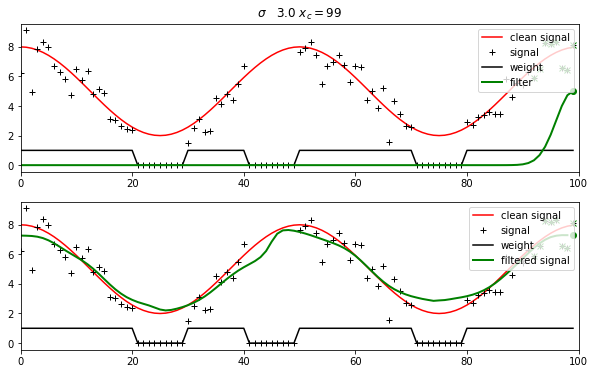

In [7]:
from IPython.display import HTML
from geog0111.demofilt4 import demofilt4

show4=HTML(demofilt4().to_jshtml())

In [8]:
show4

The result is not as good as we got above, but that is hardly surprising: we are interpolating here and it is hard to interpolate over large gaps.

Since the gaps are quite large, we might benefit from using a larger filter extent. This is then liable to degrade the quality somewhat (over smooth) in data rich areas. These are typical trade-offs we must balance.


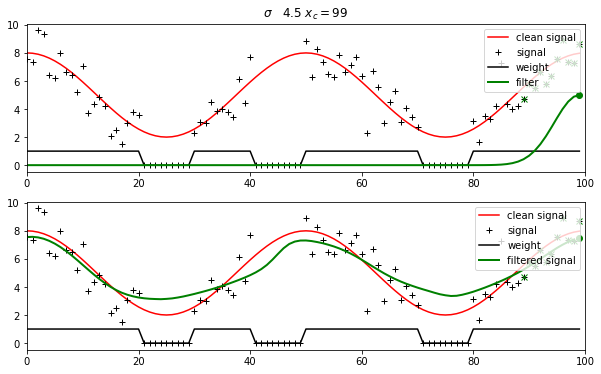

In [9]:
from IPython.display import HTML
from geog0111.demofilt5 import demofilt5

show5=HTML(demofilt5().to_jshtml())

In [10]:
show5

## Summary

In this section, we have learnt about weighted regularisation, and how trhis is related to smoothing and interpolation. We can now go on to use these ideas to improive the data in our MODIS datasets. We can call this an improvement, provided the assumptions underlying our regularisation are correct. These are essentially, that the data should be smoothly varying in time, to a given degree of smoothness, and that the noise is stationary, i.e. the same over the whole signal. You should ideally test your data to see if they meet these conditions, and conbsider variations in approach if yoiu encounter violations. Whilst we have not concentrated on the uncertainty of the regularised signals here, in any scientific application, this is an important part of the analysis. 


[<img src="images/noun_post_2109127.svg" width="50" align='right'>](016_Python_for.ipynb)
[<img src="images/noun_pre_2109128.svg" width="50" align='right'>](018_Python_xxx.ipynb)
